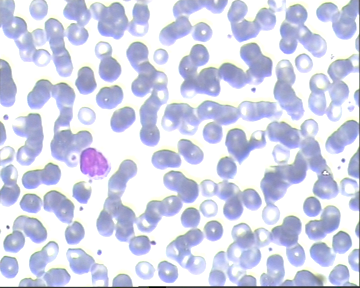

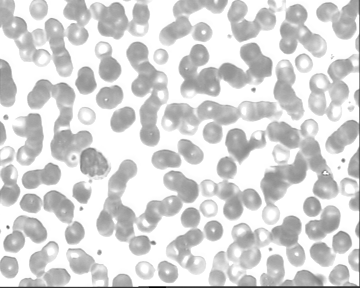

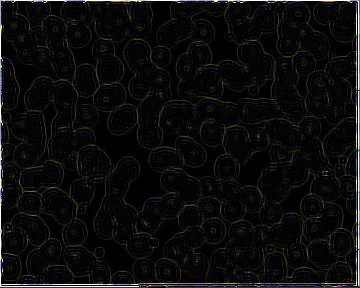

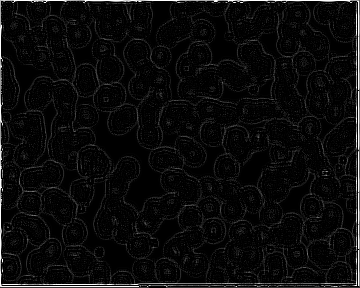

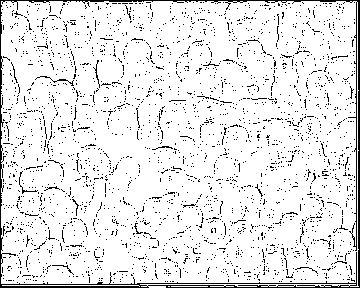

...

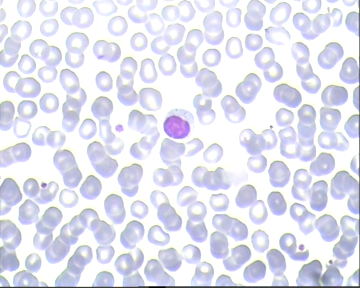

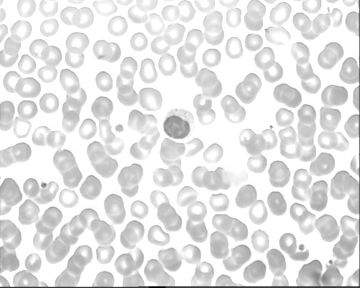

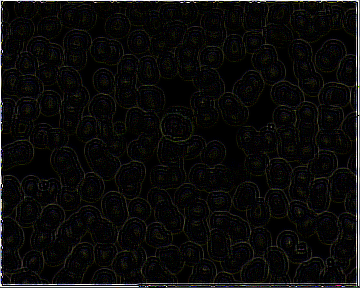

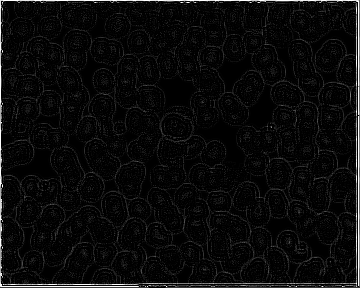

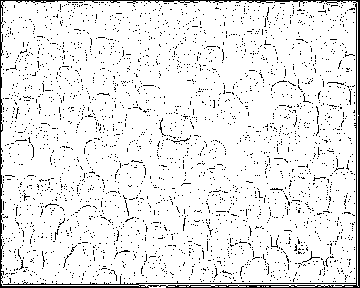

52


In [128]:
from os import listdir
from PIL import Image as PImage
#from matplotlib.pyplot import imshow
#import numpy as np
from IPython.display import display
from skfuzzy import fuzzymath as fmath
import numpy as np
from PIL import ImageFilter

def loadImages(path):
    # return array of images

    imagesList = listdir(path)
    loadedImages = []
    for image in imagesList:
        img = PImage.open(path + image)
        img = img.resize( [int(0.5 * s) for s in img.size] )
        loadedImages.append(img)

    return loadedImages

def convertToGray(imgs):
    loadedImages = []
    for img in imgs:
        img=img.convert('L')
        loadedImages.append(img)
        
    return loadedImages


def edge(imgs):
    loadedImages = []
    for img in imgs:
        img=img.filter(ImageFilter.BLUR)
        img=img.filter(ImageFilter.SMOOTH_MORE)
        img=img.filter(ImageFilter.DETAIL)
        img=img.filter(ImageFilter.SHARPEN)
        img=img.filter(ImageFilter.FIND_EDGES)
        #img=img.filter(ImageFilter.CONTOUR)
        #img=img.filter(ImageFilter.EMBOSS)
        loadedImages.append(img)
        
    return loadedImages


def binarisation(imgs):
    loadedImages = []
    for img in imgs:
        #img=img.convert('L').point(lambda x: 0 if x<128 else 255, '1')
        img=img.convert('L').point(lambda x: 255 if x<30 else 0, '1')
        loadedImages.append(img)
        
    return loadedImages

path = "./lymp/"

# your images in an array
imgs = loadImages(path)
imgs2= convertToGray(imgs)
#imgs3=binarisation(imgs)
imgs4=edge(imgs)
imgs5=edge(imgs2)
imgs6=binarisation(imgs5)

counter=0
for img, img2, img4, img5, img6 in zip(imgs, imgs2, imgs4, imgs5, imgs6):
    # you can show every image
    counter=counter+1
    display(img)
    img_array = np.asarray(img)
    img2_array= np.asarray(img2)

    #np.multiply(img2_array,img_array.sum(axis=2))
    #img2=PImage.fromarray(img_array)
    display(img2)
    display(img4)
    display(img5)
    display(img6)
    
print(counter)
